# Product Segmentation using K-means Clustering

In [12]:
# Import our dependencies
import pandas as pd
from sklearn.cluster import KMeans
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler,OneHotEncoder
import tensorflow as tf
import plotly.express as px
import hvplot.pandas
from config import db_password 

import warnings
warnings.filterwarnings('ignore')

In [13]:
# Using pandas to execute SQL queries
# Import dependencies
from sqlalchemy import create_engine
from config import db_password
import psycopg2

#Create a connection to the RDS instance
connection = psycopg2.connect(
    host = 'instacart-db.crrysho2rjsv.us-east-2.rds.amazonaws.com',
    port = 5432,
    user = 'postgres',
    password = db_password,
    database='instacart'
    )
cursor=connection.cursor()

In [14]:
# Read the Products dataset
sql = "select * from products"
products_df = pd.read_sql(sql, con=connection)
products_df.head()

# Drop Null Values from datasets
products_df.dropna()

,product_id,product_name,aisle_id,department_id
0,1,Chocolate Sandwich Cookies,61,19
1,2,All-Seasons Salt,104,13
2,3,Robust Golden Unsweetened Oolong Tea,94,7
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1
4,5,Green Chile Anytime Sauce,5,13
...,...,...,...,...
49683,49684,"Vodka, Triple Distilled, Twist of Vanilla",124,5
49684,49685,En Croute Roast Hazelnut Cranberry,42,1
49685,49686,Artisan Baguette,112,3
49686,49687,Smartblend Healthy Metabolism Dry Cat Food,41,8


In [15]:
# Read the Department dataset
sql = "select * from departments"
dept_df = pd.read_sql(sql, con=connection)
dept_df.head()

# Drop Null Values from datasets
dept_df.dropna()

,department_id,department
0,1,frozen
1,2,other
2,3,bakery
3,4,produce
4,5,alcohol
5,6,international
6,7,beverages
7,8,pets
8,9,dry goods pasta
9,10,bulk


In [16]:
# Read the Departments dataset
sql = "select * from aisles"
aisles_df = pd.read_sql(sql, con=connection)
aisles_df.head()

# Drop Null Values from datasets
aisles_df.dropna()

,aisle_id,aisle
0,1,prepared soups salads
1,2,specialty cheeses
2,3,energy granola bars
3,4,instant foods
4,5,marinades meat preparation
...,...,...
129,130,hot cereal pancake mixes
130,131,dry pasta
131,132,beauty
132,133,muscles joints pain relief


In [17]:
# Get the number of Reorders by product from the database table
sql = "select product_id, num_of_reorders from reorders_by_product"
reordprod_df = pd.read_sql(sql, con=connection)
reordprod_df

,product_id,num_of_reorders
0,1,70
1,2,1
2,3,8
3,4,12
4,5,1
...,...,...
40428,49682,2
40429,49683,4163
40430,49685,1
40431,49686,7


In [18]:
# Get the number of Orders by product from the database table
sql = "select product_id, num_of_orders from orders_by_product"
orders_prod_df = pd.read_sql(sql, con=connection)
orders_prod_df

,product_id,num_of_orders
0,1,105
1,2,10
2,3,9
3,4,26
4,5,1
...,...,...
40428,49682,8
40429,49683,5985
40430,49685,5
40431,49686,11


In [19]:
# Join the products and departments
products_df = products_df.merge(dept_df, on="department_id", how="left")
products_df

,product_id,product_name,aisle_id,department_id,department
0,1,Chocolate Sandwich Cookies,61,19,snacks
1,2,All-Seasons Salt,104,13,pantry
2,3,Robust Golden Unsweetened Oolong Tea,94,7,beverages
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1,frozen
4,5,Green Chile Anytime Sauce,5,13,pantry
...,...,...,...,...,...
49683,49684,"Vodka, Triple Distilled, Twist of Vanilla",124,5,alcohol
49684,49685,En Croute Roast Hazelnut Cranberry,42,1,frozen
49685,49686,Artisan Baguette,112,3,bakery
49686,49687,Smartblend Healthy Metabolism Dry Cat Food,41,8,pets


In [20]:
# Join the products and deaprtments, aisles datasets
products_df = products_df.merge(aisles_df, on="aisle_id", how="left")
products_df

,product_id,product_name,aisle_id,department_id,department,aisle
0,1,Chocolate Sandwich Cookies,61,19,snacks,cookies cakes
1,2,All-Seasons Salt,104,13,pantry,spices seasonings
2,3,Robust Golden Unsweetened Oolong Tea,94,7,beverages,tea
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1,frozen,frozen meals
4,5,Green Chile Anytime Sauce,5,13,pantry,marinades meat preparation
...,...,...,...,...,...,...
49683,49684,"Vodka, Triple Distilled, Twist of Vanilla",124,5,alcohol,spirits
49684,49685,En Croute Roast Hazelnut Cranberry,42,1,frozen,frozen vegan vegetarian
49685,49686,Artisan Baguette,112,3,bakery,bread
49686,49687,Smartblend Healthy Metabolism Dry Cat Food,41,8,pets,cat food care


In [21]:
# Join the Reorders and Orders dataset
products_df = products_df.merge(reordprod_df, on="product_id", how="left")
products_df

,product_id,product_name,aisle_id,department_id,department,aisle,num_of_reorders
0,1,Chocolate Sandwich Cookies,61,19,snacks,cookies cakes,70.0
1,2,All-Seasons Salt,104,13,pantry,spices seasonings,1.0
2,3,Robust Golden Unsweetened Oolong Tea,94,7,beverages,tea,8.0
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1,frozen,frozen meals,12.0
4,5,Green Chile Anytime Sauce,5,13,pantry,marinades meat preparation,1.0
...,...,...,...,...,...,...,...
49683,49684,"Vodka, Triple Distilled, Twist of Vanilla",124,5,alcohol,spirits,NaN
49684,49685,En Croute Roast Hazelnut Cranberry,42,1,frozen,frozen vegan vegetarian,1.0
49685,49686,Artisan Baguette,112,3,bakery,bread,7.0
49686,49687,Smartblend Healthy Metabolism Dry Cat Food,41,8,pets,cat food care,NaN


In [22]:
# Join the products and deaprtments, aisles datasets
products_df = products_df.merge(orders_prod_df, on="product_id", how="left")
products_df

,product_id,product_name,aisle_id,department_id,department,aisle,num_of_reorders,num_of_orders
0,1,Chocolate Sandwich Cookies,61,19,snacks,cookies cakes,70.0,105.0
1,2,All-Seasons Salt,104,13,pantry,spices seasonings,1.0,10.0
2,3,Robust Golden Unsweetened Oolong Tea,94,7,beverages,tea,8.0,9.0
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1,frozen,frozen meals,12.0,26.0
4,5,Green Chile Anytime Sauce,5,13,pantry,marinades meat preparation,1.0,1.0
...,...,...,...,...,...,...,...,...
49683,49684,"Vodka, Triple Distilled, Twist of Vanilla",124,5,alcohol,spirits,NaN,NaN
49684,49685,En Croute Roast Hazelnut Cranberry,42,1,frozen,frozen vegan vegetarian,1.0,5.0
49685,49686,Artisan Baguette,112,3,bakery,bread,7.0,11.0
49686,49687,Smartblend Healthy Metabolism Dry Cat Food,41,8,pets,cat food care,NaN,NaN


In [23]:
# Fill Null values for num_of_orders by 0
products_df.num_of_orders.fillna(0, inplace=True)
products_df

,product_id,product_name,aisle_id,department_id,department,aisle,num_of_reorders,num_of_orders
0,1,Chocolate Sandwich Cookies,61,19,snacks,cookies cakes,70.0,105.0
1,2,All-Seasons Salt,104,13,pantry,spices seasonings,1.0,10.0
2,3,Robust Golden Unsweetened Oolong Tea,94,7,beverages,tea,8.0,9.0
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1,frozen,frozen meals,12.0,26.0
4,5,Green Chile Anytime Sauce,5,13,pantry,marinades meat preparation,1.0,1.0
...,...,...,...,...,...,...,...,...
49683,49684,"Vodka, Triple Distilled, Twist of Vanilla",124,5,alcohol,spirits,NaN,0.0
49684,49685,En Croute Roast Hazelnut Cranberry,42,1,frozen,frozen vegan vegetarian,1.0,5.0
49685,49686,Artisan Baguette,112,3,bakery,bread,7.0,11.0
49686,49687,Smartblend Healthy Metabolism Dry Cat Food,41,8,pets,cat food care,NaN,0.0


In [24]:
# Fill Null values for num_of_reorders by 0
products_df.num_of_reorders.fillna(0, inplace=True)
products_df

,product_id,product_name,aisle_id,department_id,department,aisle,num_of_reorders,num_of_orders
0,1,Chocolate Sandwich Cookies,61,19,snacks,cookies cakes,70.0,105.0
1,2,All-Seasons Salt,104,13,pantry,spices seasonings,1.0,10.0
2,3,Robust Golden Unsweetened Oolong Tea,94,7,beverages,tea,8.0,9.0
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1,frozen,frozen meals,12.0,26.0
4,5,Green Chile Anytime Sauce,5,13,pantry,marinades meat preparation,1.0,1.0
...,...,...,...,...,...,...,...,...
49683,49684,"Vodka, Triple Distilled, Twist of Vanilla",124,5,alcohol,spirits,0.0,0.0
49684,49685,En Croute Roast Hazelnut Cranberry,42,1,frozen,frozen vegan vegetarian,1.0,5.0
49685,49686,Artisan Baguette,112,3,bakery,bread,7.0,11.0
49686,49687,Smartblend Healthy Metabolism Dry Cat Food,41,8,pets,cat food care,0.0,0.0


In [25]:
# Find top ten Reordered Products
topten_ords_df = products_df.sort_values(ascending=False, by="num_of_orders")
topten_ords_df = topten_ords_df[:10]
topten_ords_df['product_id'] = topten_ords_df['product_id'].astype(str)

# Find top ten Reordered Products
topten_reords_df = products_df.sort_values(ascending=False, by="num_of_reorders")
topten_reords_df = topten_reords_df[:10]
topten_reords_df['product_id'] = topten_ords_df['product_id'].astype(str)
topten_ords_df

,product_id,product_name,aisle_id,department_id,department,aisle,num_of_reorders,num_of_orders
24851,24852,Banana,24,4,produce,fresh fruits,24666.0,29256.0
13175,13176,Bag of Organic Bananas,24,4,produce,fresh fruits,19223.0,23257.0
21137,21137,Organic Strawberries,24,4,produce,fresh fruits,12596.0,16115.0
21902,21903,Organic Baby Spinach,123,4,produce,packaged vegetables fruits,11431.0,14822.0
47208,47209,Organic Hass Avocado,24,4,produce,fresh fruits,10384.0,13107.0
47766,47766,Organic Avocado,24,4,produce,fresh fruits,8207.0,10766.0
47625,47626,Large Lemon,24,4,produce,fresh fruits,6568.0,9403.0
16796,16797,Strawberries,24,4,produce,fresh fruits,6180.0,8882.0
26208,26209,Limes,24,4,produce,fresh fruits,5967.0,8701.0
27844,27845,Organic Whole Milk,84,16,dairy eggs,milk,7075.0,8471.0


In [26]:
px.bar(topten_ords_df, x = "product_name", y="num_of_orders",  color="aisle", title="Top Ten Products Ordered", hover_data=['department'])

In [27]:
fig = px.bar(topten_reords_df, x = "product_name", y="num_of_reorders", color="aisle",  title="Top Ten Products Re-ordered", hover_data=['department'])
fig.show()

In [28]:
prod_save_df = products_df.copy()
# Drop the columns from Products Dataframe which are not features and cannot be used for clustering
products_df.drop(columns=["product_name", "aisle_id", "department_id", "product_id"], inplace=True)
products_df

,department,aisle,num_of_reorders,num_of_orders
0,snacks,cookies cakes,70.0,105.0
1,pantry,spices seasonings,1.0,10.0
2,beverages,tea,8.0,9.0
3,frozen,frozen meals,12.0,26.0
4,pantry,marinades meat preparation,1.0,1.0
...,...,...,...,...
49683,alcohol,spirits,0.0,0.0
49684,frozen,frozen vegan vegetarian,1.0,5.0
49685,bakery,bread,7.0,11.0
49686,pets,cat food care,0.0,0.0


In [29]:
# Use get_dummies() to create variables for text features.
X = pd.get_dummies(products_df, columns=["department", "aisle"])
X

,num_of_reorders,num_of_orders,department_alcohol,department_babies,department_bakery,department_beverages,department_breakfast,department_bulk,department_canned goods,department_dairy eggs,...,aisle_spreads,aisle_tea,aisle_tofu meat alternatives,aisle_tortillas flat bread,aisle_trail mix snack mix,aisle_trash bags liners,aisle_vitamins supplements,aisle_water seltzer sparkling water,aisle_white wines,aisle_yogurt
0,70.0,105.0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
1,1.0,10.0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
2,8.0,9.0,0,0,0,1,0,0,0,0,...,0,1,0,0,0,0,0,0,0,0
3,12.0,26.0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
4,1.0,1.0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
49683,0.0,0.0,1,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
49684,1.0,5.0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
49685,7.0,11.0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
49686,0.0,0.0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0


In [30]:
# Elbow curve for Products dataset
inertia = []
k = list(range(1, 11))

# Calculate the inertia for the range of K values
for i in k:
   km = KMeans(n_clusters=i, random_state=0)
   km.fit(X)
   inertia.append(km.inertia_)

# Define a DataFrame to plot the Elbow Curve using hvPlot
elbow_data = {"k": k, "inertia": inertia}
df_elbow = pd.DataFrame(elbow_data)
df_elbow.hvplot.line(x="k", y="inertia", title="Elbow Curve - Products", xticks=k)

:Curve   [k]   (inertia)

### The Elbow curve suggests the number of clusters between 3-5, similar to our previous Elbow curve. 
### Having plotted values of k from 3-5, we settled on k=4.

In [31]:
# Initialize the K-Means model; Use k=4 from the Elbow curve
kmeans_model = KMeans(n_clusters=4, random_state=0)
kmeans_model
    
# Fit the model
kmeans_model.fit(X)

# Predict clusters
predictions = kmeans_model.predict(X)
predictions

array([0, 0, 0, ..., 0, 0, 0])

In [32]:
# Create a new DataFrame including predicted clusters and Products features.
clustered_df = pd.DataFrame(prod_save_df)

#  Add a new column, "Class" to the clustered_df DataFrame that holds the predictions.
clustered_df["Class"] = predictions 

# Print the shape of the clustered_df
print(clustered_df.shape)
clustered_df.head(10)

(49688, 9)


,product_id,product_name,aisle_id,department_id,department,aisle,num_of_reorders,num_of_orders,Class
0,1,Chocolate Sandwich Cookies,61,19,snacks,cookies cakes,70.0,105.0,0
1,2,All-Seasons Salt,104,13,pantry,spices seasonings,1.0,10.0,0
2,3,Robust Golden Unsweetened Oolong Tea,94,7,beverages,tea,8.0,9.0,0
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1,frozen,frozen meals,12.0,26.0,0
4,5,Green Chile Anytime Sauce,5,13,pantry,marinades meat preparation,1.0,1.0,0
5,6,Dry Nose Oil,11,11,personal care,cold flu allergy,0.0,0.0,0
6,7,Pure Coconut Water With Orange,98,7,beverages,juice nectars,0.0,0.0,0
7,8,Cut Russet Potatoes Steam N' Mash,116,1,frozen,frozen produce,0.0,4.0,0
8,9,Light Strawberry Blueberry Yogurt,120,16,dairy eggs,yogurt,3.0,10.0,0
9,10,Sparkling Orange Juice & Prickly Pear Beverage,115,7,beverages,water seltzer sparkling water,64.0,131.0,0


In [33]:
clustered_df.Class.value_counts()

0    49107
3      517
1       59
2        5
Name: Class, dtype: int64

In [34]:
clustered_df.num_of_reorders.describe()

count    49688.000000
mean        23.670806
std        221.265943
min          0.000000
25%          0.000000
50%          1.000000
75%          7.000000
max      24666.000000
Name: num_of_reorders, dtype: float64

# Products are grouped into 4 clusters -
- Class 0 - never re-ordered
- Class 1 - occasionally re-ordered
- Class 2 - often re-ordered or Popular.
- Class 3 - frequently re-ordered or “In-High Demand”.


In [45]:
# Create a hvplot.scatter plot 
clustered_df.hvplot.scatter(x="num_of_reorders", y="num_of_orders", by="Class", hover_alpha = "product_name")

:NdOverlay   [Class]
   :Scatter   [num_of_reorders]   (num_of_orders)

In [36]:
# Creating a 3D-Scatter with the data and the clusters
fig = px.scatter_3d(
    clustered_df,
    x="product_id",
    y="num_of_orders",
    z="num_of_reorders",
    hover_name = "product_name",
    hover_data =  ["aisle", "department"],
    color="Class",
    symbol="Class",
    width=800,
)
fig.update_layout(legend=dict(x=0, y=1))
fig.show()


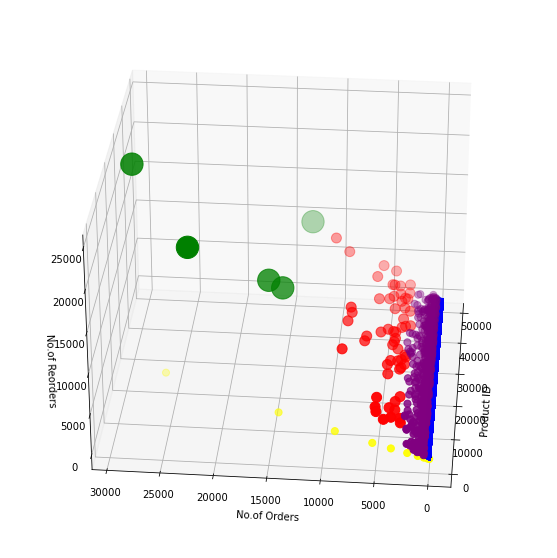

In [37]:
from mpl_toolkits.mplot3d import Axes3D
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
 
fig = plt.figure(figsize=(20,10))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(clustered_df.product_id[clustered_df.Class == 0], clustered_df["num_of_orders"][clustered_df.Class == 0], clustered_df["num_of_reorders"][clustered_df.Class == 0], c='blue', s=5)
ax.scatter(clustered_df.product_id[clustered_df.Class == 1], clustered_df["num_of_orders"][clustered_df.Class == 1], clustered_df["num_of_reorders"][clustered_df.Class == 1], c='red', s=100)
ax.scatter(clustered_df.product_id[clustered_df.Class == 2], clustered_df["num_of_orders"][clustered_df.Class == 2], clustered_df["num_of_reorders"][clustered_df.Class == 2], c='green', s=500)
ax.scatter(clustered_df.product_id[clustered_df.Class == 3], clustered_df["num_of_orders"][clustered_df.Class == 3], clustered_df["num_of_reorders"][clustered_df.Class == 3], c='purple', s=50)
ax.view_init(30, 185)
plt.scatter(km.cluster_centers_[:,0], km.cluster_centers_[:, 1], s = 50, c = 'yellow' , label = 'centeroid')
plt.xlabel("Product ID")
plt.ylabel("No.of Orders")
ax.set_zlabel('No.of Reorders')
plt.show()

# Let's try using Principal Component Analysis


### Principal Component Analysis reduces the number of input features to a specified number of key features.
### For our analysis, we want to check if we get different results by reducing the number of features to 3? 

In [38]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Standardize the data with StandardScaler().
products_df_scaled = StandardScaler().fit_transform(X)
products_df_scaled[0:5]

# Using PCA to reduce dimension to three principal components.
pca = PCA(n_components=3)
products_pca = pca.fit_transform(X)
products_pca

array([[ 7.97403417e+01, -1.87367990e+00,  7.73533219e-01],
       [-3.76601003e+01, -1.03151868e-01, -8.44353914e-03],
       [-3.42615945e+01,  6.09852356e+00,  1.11416265e-03],
       ...,
       [-3.32610972e+01,  4.09839755e+00,  4.35037408e-04],
       [-4.62613539e+01,  5.09541112e+00,  2.00093199e-03],
       [-3.86606077e+01,  1.89797526e+00, -6.86314338e-01]])

In [39]:
# Create a DataFrame with the three principal components.
pcs_df = pd.DataFrame(data=products_pca, columns=["PC 1", "PC 2", "PC 3"], index=None)
pcs_df

,PC 1,PC 2,PC 3
0,79.740342,-1.873680,0.773533
1,-37.660100,-0.103152,-0.008444
2,-34.261595,6.098524,0.001114
3,-18.259889,-0.898054,-0.004020
4,-44.861416,5.295179,-0.005402
...,...,...,...
49683,-46.261352,5.095349,0.001927
49684,-41.660814,2.896187,-0.001695
49685,-33.261097,4.098398,0.000435
49686,-46.261354,5.095411,0.002001


In [40]:
# Create an elbow curve to find the best value for K.
inertia = []
k = list(range(1, 11))

# Calculate the inertia for the range of K values
for i in k:
   km = KMeans(n_clusters=i, random_state=0)
   km.fit(pcs_df)
   inertia.append(km.inertia_)

elbow_data = {"k": k, "inertia": inertia}
df_elbow = pd.DataFrame(elbow_data)
df_elbow.hvplot.line(x="k", y="inertia", title="Elbow Curve", xticks=k, )

:Curve   [k]   (inertia)

### The Elbow curve suggests the number of clusters between 3-5, similar to our previous Elbow curve. 
### Hence, we didn't get different results as such using PCA.

In [41]:
# Initialize the K-Means model; Use k=4 from the Elbow curve
kmeans_model = KMeans(n_clusters=4, random_state=0)
kmeans_model
    
# Fit the model
kmeans_model.fit(pcs_df)

# Predict clusters
predictions = kmeans_model.predict(pcs_df)
predictions

array([0, 0, 0, ..., 0, 0, 0])

In [42]:
# Create a new DataFrame including predicted clusters and cryptocurrencies features.
# Concatentate the crypto_df and pcs_df DataFrames on the same columns.
clustered_df = prod_save_df.join(pcs_df)

#  Add a new column, "Class" to the clustered_df DataFrame that holds the predictions.
clustered_df["Class"] = predictions 

# Print the shape of the clustered_df
print(clustered_df.shape)
clustered_df.head(10)

(49688, 12)


,product_id,product_name,aisle_id,department_id,department,aisle,num_of_reorders,num_of_orders,Class,PC 1,PC 2,PC 3
0,1,Chocolate Sandwich Cookies,61,19,snacks,cookies cakes,70.0,105.0,0,79.740342,-1.873680,0.773533
1,2,All-Seasons Salt,104,13,pantry,spices seasonings,1.0,10.0,0,-37.660100,-0.103152,-0.008444
2,3,Robust Golden Unsweetened Oolong Tea,94,7,beverages,tea,8.0,9.0,0,-34.261595,6.098524,0.001114
3,4,Smart Ones Classic Favorites Mini Rigatoni Wit...,38,1,frozen,frozen meals,12.0,26.0,0,-18.259889,-0.898054,-0.004020
4,5,Green Chile Anytime Sauce,5,13,pantry,marinades meat preparation,1.0,1.0,0,-44.861416,5.295179,-0.005402
5,6,Dry Nose Oil,11,11,personal care,cold flu allergy,0.0,0.0,0,-46.261389,5.096128,-0.700269
6,7,Pure Coconut Water With Orange,98,7,beverages,juice nectars,0.0,0.0,0,-46.261348,5.095583,0.000901
7,8,Cut Russet Potatoes Steam N' Mash,116,1,frozen,frozen produce,0.0,4.0,0,-43.060762,2.695708,-0.002127
8,9,Light Strawberry Blueberry Yogurt,120,16,dairy eggs,yogurt,3.0,10.0,0,-36.460423,1.497470,-0.004276
9,10,Sparkling Orange Juice & Prickly Pear Beverage,115,7,beverages,water seltzer sparkling water,64.0,131.0,0,96.945343,-22.269397,-0.013202


### We have 4 product Clusters as before- 
- Class 0 - never re-ordered
- Class 1 - occasionally re-ordered
- Class 2 - often re-ordered or Popular.
- Class 3 - frequently re-ordered or “In-High Demand”.

In [43]:
# Creating a 3D-Scatter with the PCA data and the clusters
fig = px.scatter_3d(
    clustered_df,
    x="PC 1",
    y="PC 2",
    z="PC 3",
    hover_name = "product_name",
    hover_data =  ["department", "aisle", "num_of_orders", "num_of_reorders"],
    color="Class",
    symbol="Class",
    width=800,
)
fig.update_layout(legend=dict(x=0, y=1))
fig.show()
